## 
模型: https://huggingface.co/stable-diffusion-v1-5/stable-diffusion-v1-5

https://huggingface.co/docs/diffusers/zh/quicktour

https://huggingface.co/docs/diffusers/zh/stable_diffusion

In [1]:
# !pip install --upgrade diffusers accelerate transformers

In [1]:
from diffusers import DiffusionPipeline

model_id = "stable-diffusion-v1-5/stable-diffusion-v1-5"
pipeline = DiffusionPipeline.from_pretrained(model_id, use_safetensors=True)
pipeline.to("cuda")
image = pipeline("capybara wants to sleep.").images[0]
image.save("diffuser_example.png")

import error: No module named 'triton'


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

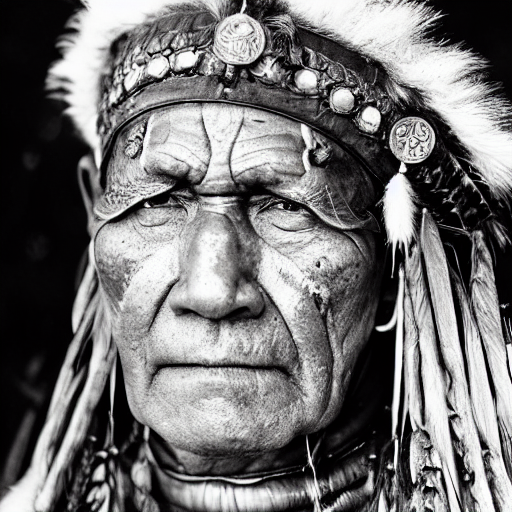

In [3]:
from diffusers import DiffusionPipeline
import torch

model_id = "stable-diffusion-v1-5/stable-diffusion-v1-5"
pipeline = DiffusionPipeline.from_pretrained(model_id, use_safetensors=True)

prompt = "portrait photo of a old warrior chief"
pipeline = pipeline.to("cuda")

generator = torch.Generator("cuda").manual_seed(0)
image = pipeline(prompt, generator=generator).images[0]
image

# 精度改成FP16

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

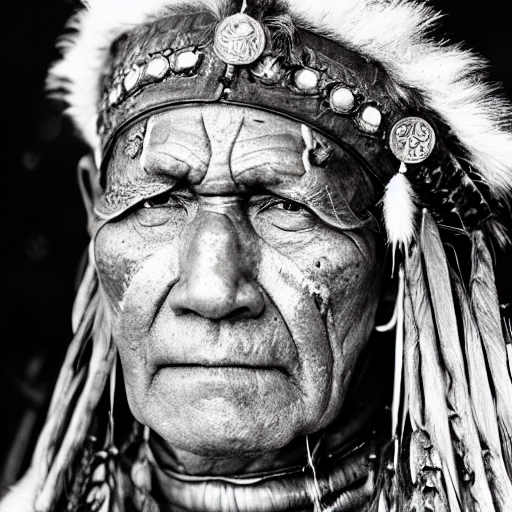

In [4]:
import torch

pipeline = DiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16, use_safetensors=True)
pipeline = pipeline.to("cuda")
generator = torch.Generator("cuda").manual_seed(0)
image = pipeline(prompt, generator=generator).images[0]
image



# 更改scheduler減少推理步數
可以透過Diffusion.Pipeline.compatibles找到目前模型兼容的scheduler <br>

Stable Diffusion 模型default預設是使用PNDMScheduler，通常要大概50步推理，
但是像 DPMSolverMultistepScheduler大概是 20 或 25 步推理。<br>
使用 ConfigMixin.from_config() 方法加载新的调度器:

reference: https://huggingface.co/docs/diffusers/api/configuration


- Download scheduler from huggingface.co and cache.<br>
`scheduler = DDPMScheduler.from_pretrained("google/ddpm-cifar10-32")`

- Instantiate DDIM scheduler class with same config as DDPM<br>
`scheduler = DDIMScheduler.from_config(scheduler.config)`

- Instantiate PNDM scheduler class with same config as DDPM<br>
`scheduler = PNDMScheduler.from_config(scheduler.config)`


In [5]:
pipeline.scheduler.compatibles

[diffusers.schedulers.scheduling_deis_multistep.DEISMultistepScheduler,
 diffusers.schedulers.scheduling_heun_discrete.HeunDiscreteScheduler,
 diffusers.schedulers.scheduling_euler_discrete.EulerDiscreteScheduler,
 diffusers.schedulers.scheduling_dpmsolver_singlestep.DPMSolverSinglestepScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_discrete.KDPM2DiscreteScheduler,
 diffusers.schedulers.scheduling_euler_ancestral_discrete.EulerAncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_ancestral_discrete.KDPM2AncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_unipc_multistep.UniPCMultistepScheduler,
 diffusers.utils.dummy_torch_and_torchsde_objects.DPMSolverSDEScheduler,
 diffusers.schedulers.scheduling_edm_euler.EDMEulerScheduler,
 diffusers.schedulers.scheduling_lms_discrete.LMSDiscreteScheduler,
 diffusers.schedulers.scheduling_dpmsolver_multistep.DPMSolverMultistepScheduler,
 diffusers.schedulers.scheduling_ddim.DDIMScheduler,
 diffusers.schedulers.scheduling

  0%|          | 0/20 [00:00<?, ?it/s]

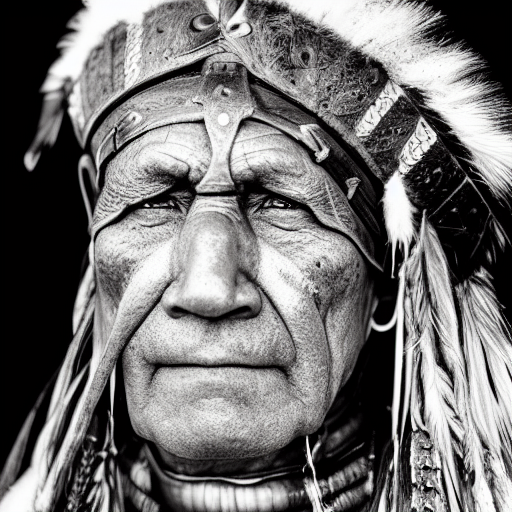

In [6]:
from diffusers import DPMSolverMultistepScheduler

pipeline.scheduler = DPMSolverMultistepScheduler.from_config(pipeline.scheduler.config)
generator = torch.Generator("cuda").manual_seed(0)
image = pipeline(prompt, generator=generator, num_inference_steps=20).images[0]
image

  0%|          | 0/20 [00:00<?, ?it/s]

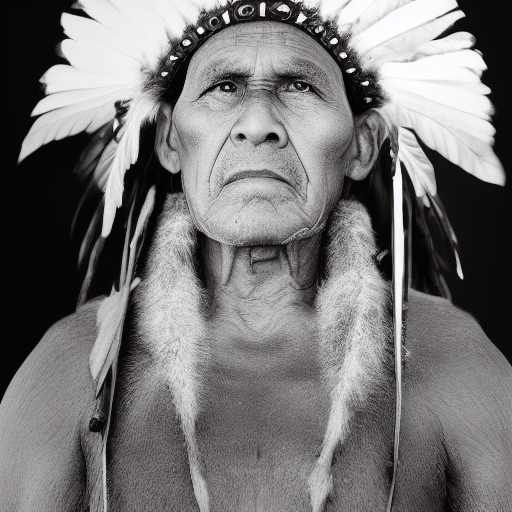

In [7]:
from diffusers import DDPMScheduler, DDIMScheduler, PNDMScheduler

pipeline.scheduler = DDPMScheduler.from_config(pipeline.scheduler.config)
generator = torch.Generator("cuda").manual_seed(0)
image = pipeline(prompt, generator=generator, num_inference_steps=20).images[0]
image

  0%|          | 0/20 [00:00<?, ?it/s]

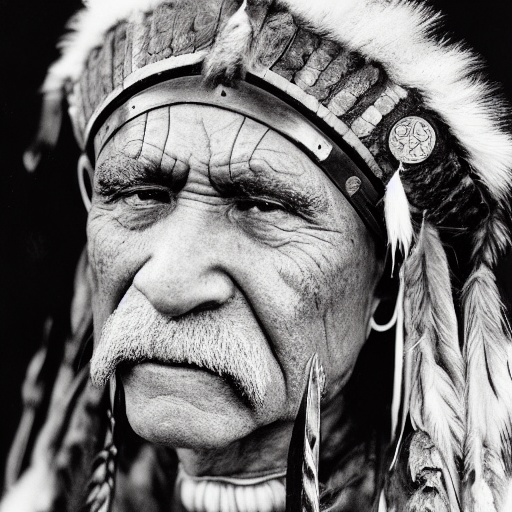

In [8]:

pipeline.scheduler = DDIMScheduler.from_config(pipeline.scheduler.config)
generator = torch.Generator("cuda").manual_seed(0)
image = pipeline(prompt, generator=generator, num_inference_steps=20).images[0]
image

  0%|          | 0/20 [00:00<?, ?it/s]

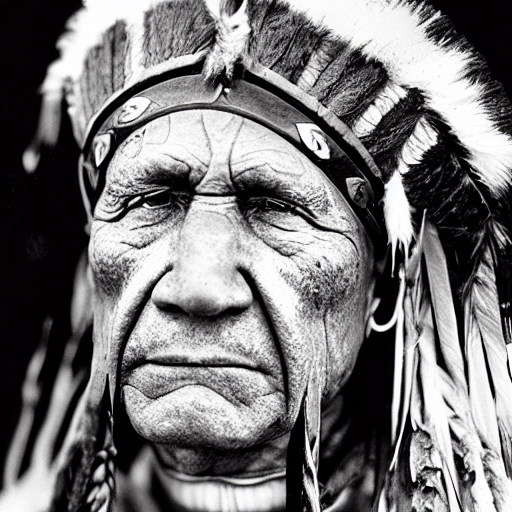

In [9]:
pipeline.scheduler = PNDMScheduler.from_config(pipeline.scheduler.config)
generator = torch.Generator("cuda").manual_seed(0)
image = pipeline(prompt, generator=generator, num_inference_steps=20).images[0]
image

# 一次多張圖
優點:利用diffusers的pipline好處是減少memory使用率，速度也快，假設GPU記憶體夠，我們也可以一次產生多張圖，也順便測試此GPU一次最多可以生產多少張圖，測試方式是嘗試不同batch size直到出現OutOfMemoryError (OOM)。



GPU Status: initial
GPU 0:
  總記憶體: 12281.50 MB
  已分配記憶體: 2661.38 MB
  已預留記憶體: 7426.00 MB
None


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

GPU Status: Model loaded
GPU 0:
  總記憶體: 12281.50 MB
  已分配記憶體: 2661.25 MB
  已預留記憶體: 7426.00 MB
None


  0%|          | 0/20 [00:00<?, ?it/s]

GPU Status: number of batch:1
GPU 0:
  總記憶體: 12281.50 MB
  已分配記憶體: 2661.31 MB
  已預留記憶體: 7426.00 MB
None


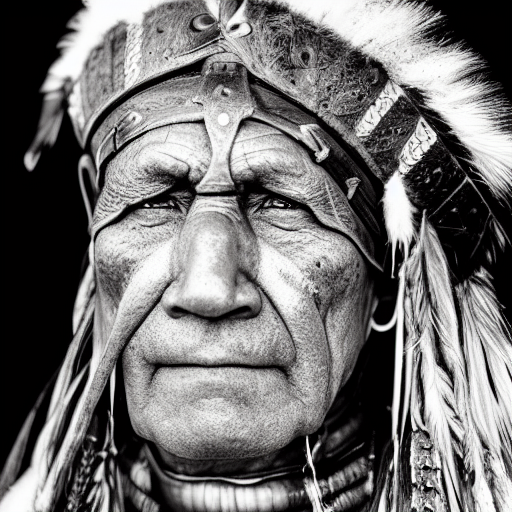

  0%|          | 0/20 [00:00<?, ?it/s]

GPU Status: number of batch:2
GPU 0:
  總記憶體: 12281.50 MB
  已分配記憶體: 2661.38 MB
  已預留記憶體: 7816.00 MB
None


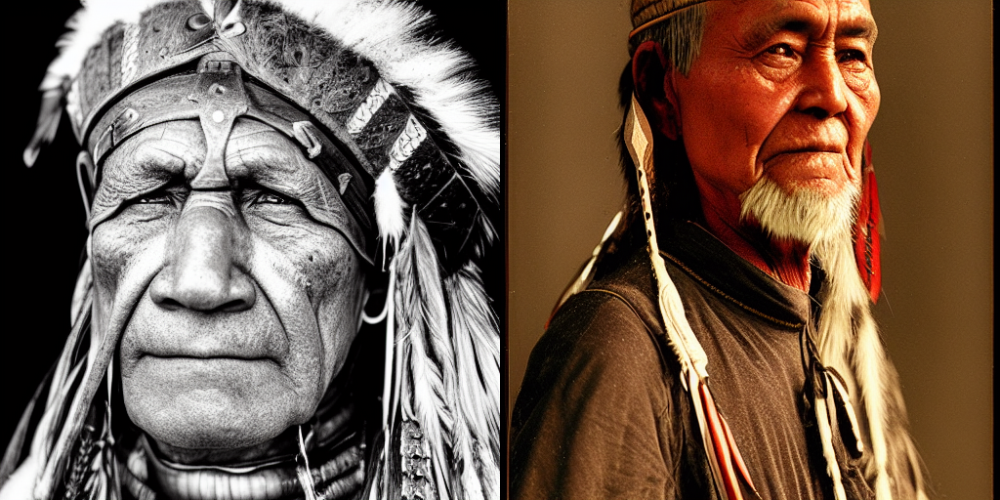

  0%|          | 0/20 [00:00<?, ?it/s]

GPU Status: number of batch:3
GPU 0:
  總記憶體: 12281.50 MB
  已分配記憶體: 2661.44 MB
  已預留記憶體: 9164.00 MB
None


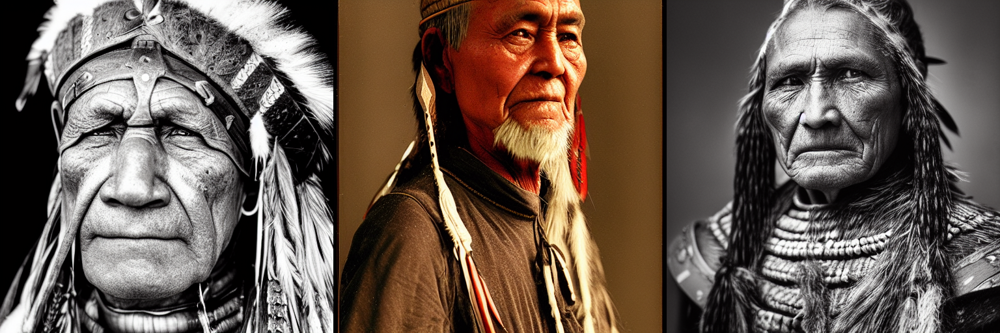

  0%|          | 0/20 [00:00<?, ?it/s]

GPU Status: number of batch:4
GPU 0:
  總記憶體: 12281.50 MB
  已分配記憶體: 2661.50 MB
  已預留記憶體: 10958.00 MB
None


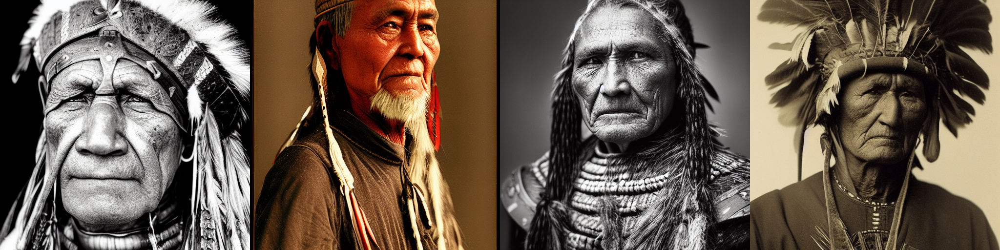

  0%|          | 0/20 [00:00<?, ?it/s]

GPU Status: number of batch:5
GPU 0:
  總記憶體: 12281.50 MB
  已分配記憶體: 2661.56 MB
  已預留記憶體: 13200.00 MB
None


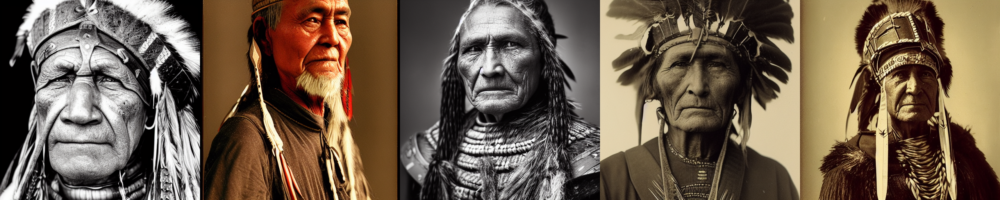

  0%|          | 0/20 [00:00<?, ?it/s]

GPU Status: number of batch:6
GPU 0:
  總記憶體: 12281.50 MB
  已分配記憶體: 2661.63 MB
  已預留記憶體: 15122.00 MB
None


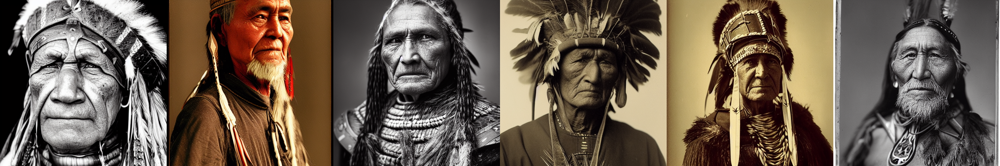

  0%|          | 0/20 [00:00<?, ?it/s]

GPU Status: number of batch:7
GPU 0:
  總記憶體: 12281.50 MB
  已分配記憶體: 2661.69 MB
  已預留記憶體: 17364.00 MB
None


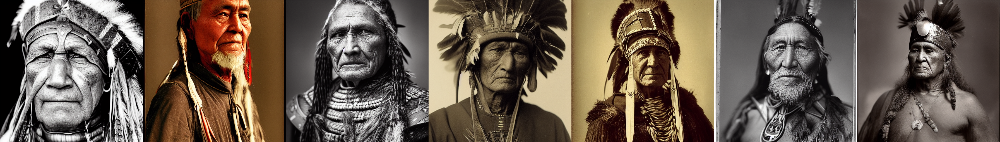

In [10]:
import torch
from diffusers.utils import make_image_grid
from diffusers import DiffusionPipeline
from diffusers import DPMSolverMultistepScheduler
def get_inputs(batch_size=1):
    generator = [torch.Generator("cuda").manual_seed(i) for i in range(batch_size)]
    prompts = batch_size * [prompt]
    num_inference_steps = 20

    return {"prompt": prompts, "generator": generator, "num_inference_steps": num_inference_steps}

def gpu_useinf():
    gpu_id = 0  # 如果有多張 GPU，改這裡
    total_memory = torch.cuda.get_device_properties(gpu_id).total_memory / 1024**2
    allocated_memory = torch.cuda.memory_allocated(gpu_id) / 1024**2
    reserved_memory = torch.cuda.memory_reserved(gpu_id) / 1024**2

    print(f"GPU {gpu_id}:")
    print(f"  總記憶體: {total_memory:.2f} MB")
    print(f"  已分配記憶體: {allocated_memory:.2f} MB")
    print(f"  已預留記憶體: {reserved_memory:.2f} MB")

print('GPU Status: initial')
print(gpu_useinf())
# 載入stable diffusion
model_id = "stable-diffusion-v1-5/stable-diffusion-v1-5"
pipeline = DiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16, use_safetensors=True)
pipeline = pipeline.to("cuda")
# scheduler改成 DPMSolverMultistepScheduler
pipeline.scheduler = DPMSolverMultistepScheduler.from_config(pipeline.scheduler.config)


print('GPU Status: Model loaded')
print(gpu_useinf())

prompt = "portrait photo of a old warrior chief"
for batch_size in range(7):
    images = pipeline(**get_inputs(batch_size=batch_size+1)).images
    print('GPU Status: number of batch:{}'.format(batch_size+1))
    print(gpu_useinf())
    display(make_image_grid(images,1,int(len(images))))

# 載入其他版本的Stability AI (AutoencoderKL)
https://huggingface.co/stabilityai/stable-diffusion-2-1/tree/main/vae




  0%|          | 0/20 [00:00<?, ?it/s]

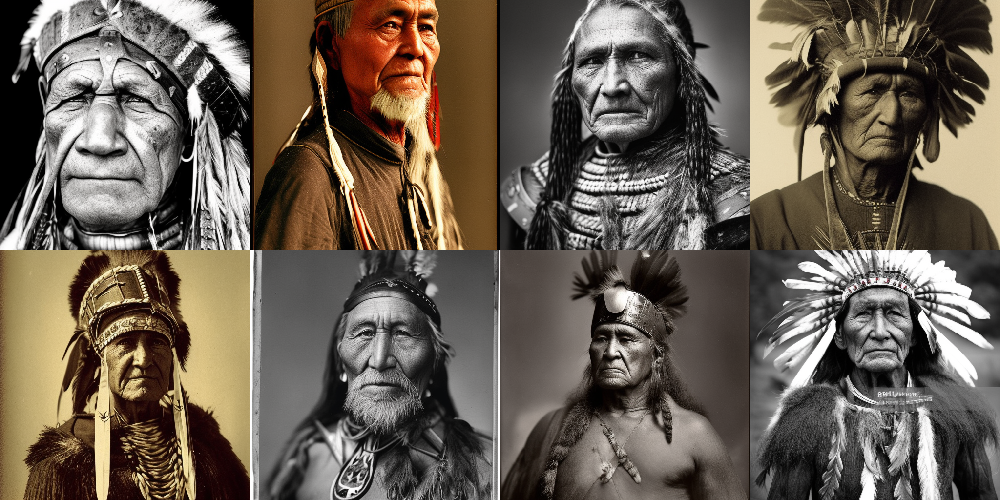

In [11]:
from diffusers import AutoencoderKL

vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-mse", torch_dtype=torch.float16).to("cuda")
pipeline.vae = vae
images = pipeline(**get_inputs(batch_size=8)).images
make_image_grid(images, rows=2, cols=4)

  0%|          | 0/20 [00:00<?, ?it/s]

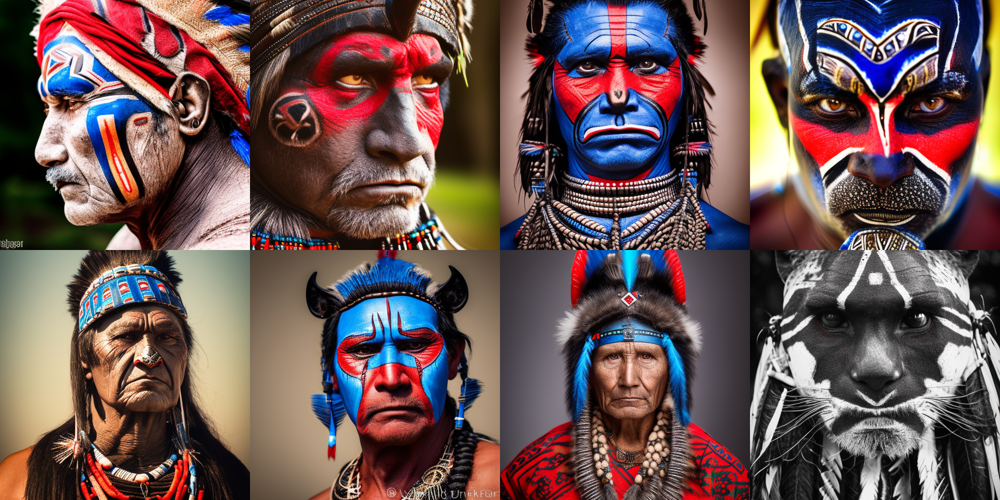

In [12]:
prompt += ", tribal panther make up, blue on red, side profile, looking away, serious eyes"
prompt += " 50mm portrait photography, hard rim lighting photography--beta --ar 2:3  --beta --upbeta"
images = pipeline(**get_inputs(batch_size=8)).images
make_image_grid(images, rows=2, cols=4)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

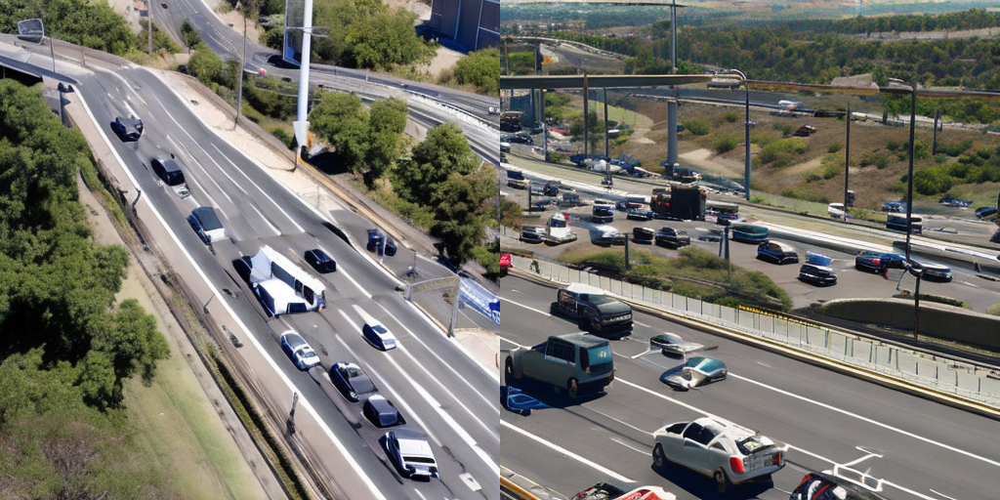

In [13]:
import torch
from diffusers.utils import make_image_grid
from diffusers import DiffusionPipeline
from diffusers import AutoencoderKL
# from diffusers import DPMSolverMultistepScheduler

def get_inputs(batch_size=1, num_inference_steps=20):
    generator = [torch.Generator("cuda").manual_seed(i) for i in range(batch_size)]
    prompts = batch_size * [prompt]
    num_inference_steps = num_inference_steps

    return {"prompt": prompts, "generator": generator, "num_inference_steps": num_inference_steps}


model_id = "stable-diffusion-v1-5/stable-diffusion-v1-5"
pipeline = DiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16, use_safetensors=True)
pipeline = pipeline.to("cuda")
# pipeline.scheduler = DPMSolverMultistepScheduler.from_config(pipeline.scheduler.config) # scheduler改成 DPMSolverMultistepScheduler

pipeline.enable_attention_slicing()
vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-mse", torch_dtype=torch.float16).to("cuda")
pipeline.vae = vae

prompt = "The surveillance camera at the intersection captured the highway scene. The size is 16:9. It is a sunny day and the traffic conditions are during rush hour."
prompt += ' 50mm portrait photography, hard rim lighting photography--beta --ar 16:9  --beta --upbeta'
images = pipeline(**get_inputs(batch_size=2, num_inference_steps=20)).images
make_image_grid(images, rows=1, cols=2)






# 提高照片解析度和利用VAE提升細節

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

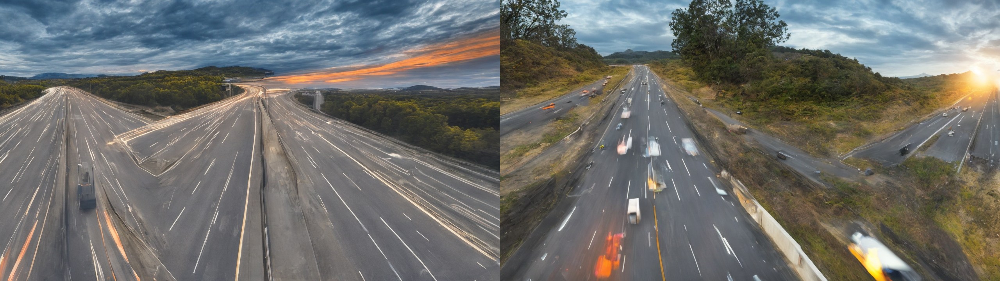

In [14]:
import torch
from diffusers.utils import make_image_grid
from diffusers import DiffusionPipeline, AutoencoderKL

def get_inputs(batch_size, 
               prompt,
               width=1280,
               height=720,
               num_inference_steps=30,
               guidance_scale=7.5):
    generator = [torch.Generator("cuda").manual_seed(i) for i in range(batch_size)]
    # generator = [torch.Generator("cuda") for i in range(batch_size)]
    prompts = batch_size * [prompt]
    num_inference_steps = 20
    return {"prompt": prompts, 
            "generator": generator, 
            "num_inference_steps": num_inference_steps,
            "width":width,
            "height":height,
            "num_inference_steps":num_inference_steps,
            "guidance_scale":guidance_scale}

# 生成 16:9 圖片的函式
def generate_image(prompt, batch_size=2, width=1280, height=720, num_inference_steps=30, guidance_scale=7.5):
    images = pipeline(**get_inputs(batch_size=batch_size,
                                   prompt=prompt,
                                   width=width,
                                   height=height,
                                   num_inference_steps=num_inference_steps,
                                   guidance_scale=guidance_scale)).images
    return images


# 設定模型 ID
model_id = "stable-diffusion-v1-5/stable-diffusion-v1-5"
# 載入 DiffusionPipeline
pipeline = DiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16, use_safetensors=True)
pipeline = pipeline.to("cuda")
# 啟用 Attention Slicing，節省顯存
pipeline.enable_attention_slicing()
# 使用更好的 VAE 來提升細節
vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-mse", torch_dtype=torch.float16).to("cuda")
pipeline.vae = vae


prompt = " A first-person view from the windshield, driving on a highway, \
                # slightly blurred motion, sunset or early morning light, \
                    smooth asphalt road with multiple lanes, cars and trucks visible in the distance."
images = generate_image(prompt, batch_size=2, 
                        width=1280, height=720, 
                        num_inference_steps=30, guidance_scale=6)
make_image_grid(images, rows=1, cols=2)
